In [109]:
install.packages('tidyverse')
install.packages('gridExtra')
install.packages('emdbook')


library(tidyverse)
library(gridExtra)
library(emdbook)

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

also installing the dependencies ‘bdsmatrix’, ‘mvtnorm’, ‘coda’, ‘bbmle’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



# Ex.1 
* study the binomial inference for a study that reports y = 7 successes in n = 20 independent trial. Assume the following priors:
    - a uniform distribution 
    - a Jeffrey's prior
    - a step function:
* plot the posterior distribution and summerize the results computing the first two moments
* compute a 95% credibility interval and give the results in a summary table
* draw the limits on the plot of the posterio distribution


### Uniform distribution prior
the normalization P($\pi$|H) dosen't depend on $\pi$

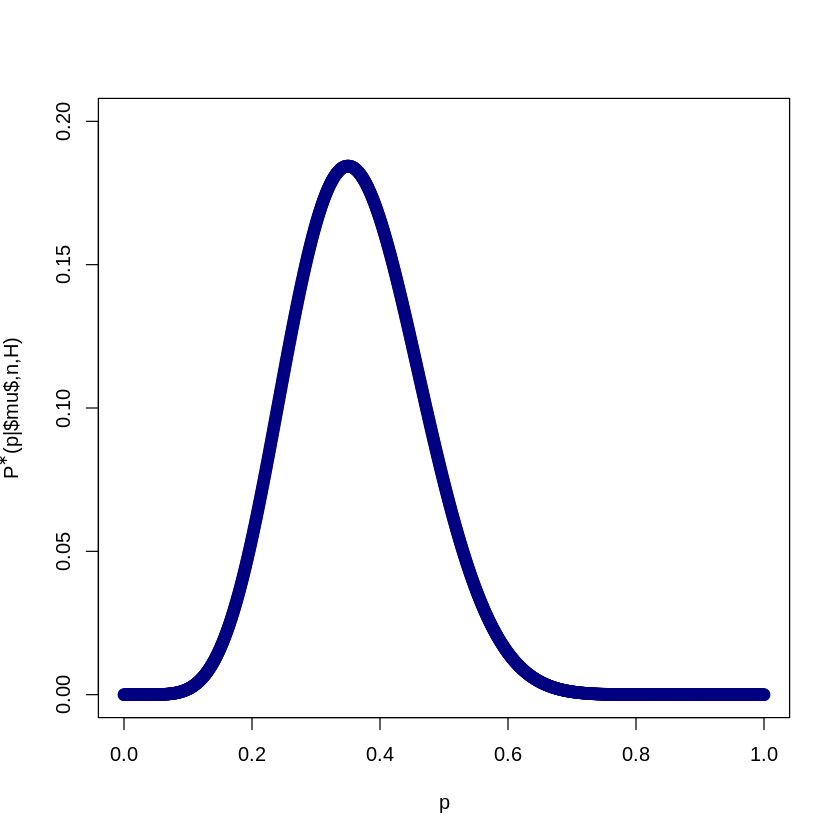

In [5]:
y <- 7   #success
n <- 20  #number of trial
mu <- seq(0,1, length.out=1000)
p.post_notnorm <- dbinom(x=y, size=n, prob=mu)
plot(mu, p.post_notnorm,
     col='navy', lty=1, lwd=3,
     ylim=c(0,0.2),
     xlab='p',
     ylab=expression(paste(P^symbol('*'), '(p|$mu$,n,H)')))

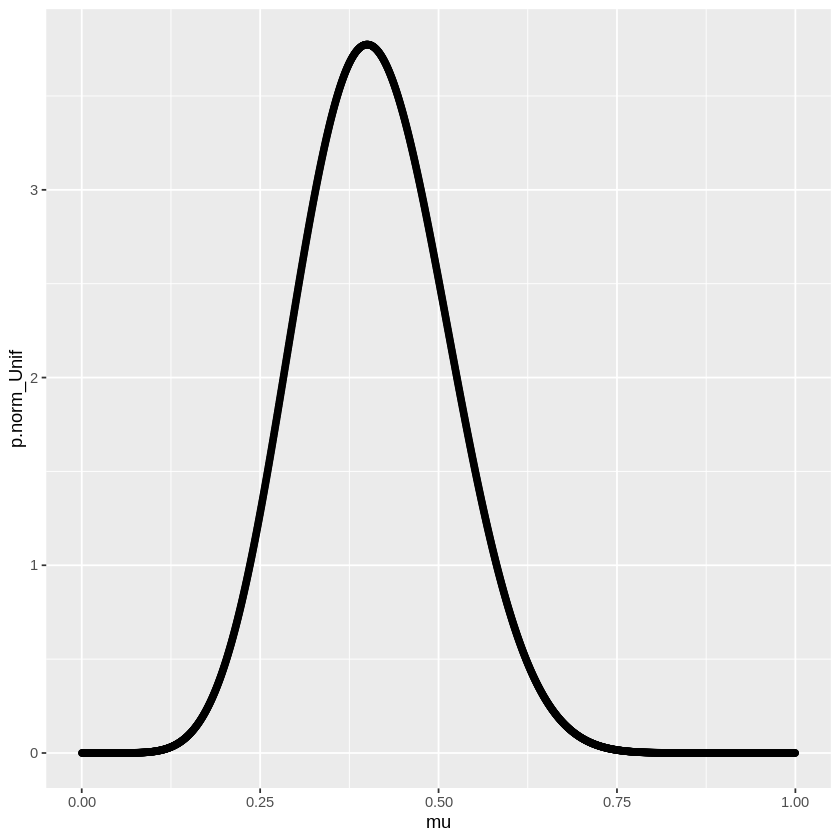

In [7]:
y <- 8
n <- 20; 
n.sample <- 2000 #number of interval in which calculate the approximate normalization function
delta.p <- 1/n.sample #length of the interval
mu <- seq(from = 1/(2*n.sample), by=1/n.sample, length.out = n.sample) #possible chose of the p in the binomial distribution, called mu 

p.star_Unif <- dbinom(x=y, size=n, prob=mu) 
p.norm_Unif <- p.star_Unif/(delta.p * sum(p.star_Unif))
# plot(p, p.norm, col='red')
# points(p, p.star, col='navy')
ggplot() +
geom_point(aes(mu, p.norm_Unif)) 

### Jeffrey's Prior
it is a prior invariant under any continous transformation of the parameter:
g($\mu$) $\propto$ $\frac{1}{\sqrt \mu}$ for $\mu > 0$

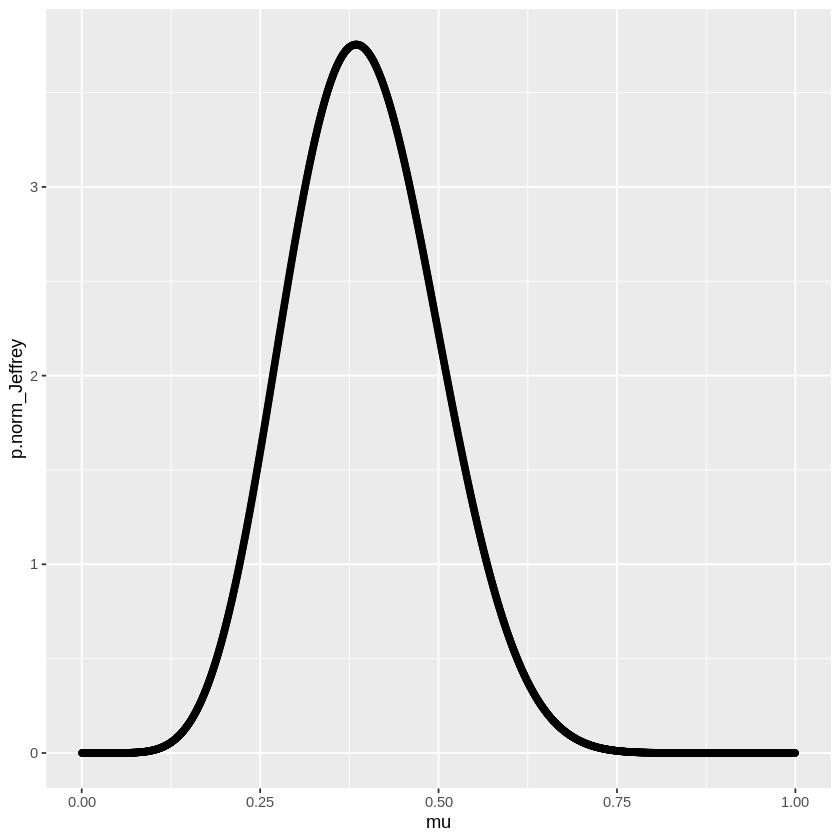

In [8]:
y <- 8
n <- 20
n.sample <- 2000
delta.p <- 1/n.sample
mu <- seq(from = 1/(2*n.sample), by=1/n.sample, length.out = n.sample)

#p.star <- dgamma(mu, shape=(y+1/2), scale=n)
# p.norm <- p.star / (delta.p * sum(p.star))
#p.norm_Jeffrey <- p.star / (integrate(function(k) {dgamma(k, shape=(y+1/2), scale=n)}, lower = 0, upper = 1))$value #return the same as the aproximated version

p.star_Jeffrey <- dbinom(x=y, size=n, prob=mu) * 1/((mu)**(1/2))
p.norm_Jeffrey <- p.star_Jeffrey / integrate(function(k) {dbinom(x=y, size=n, prob=k) * 1/((k)**(1/2)) }, lower = 0, upper = 1)$value


ggplot() +
geom_point(aes(mu, p.norm_Jeffrey))

### Step function

In [9]:
y <- 8
n <- 20
mu <- seq(0,1,length.out = 2000)

g  <- function(k) {
        g.val <- ifelse(k <= 0.2,
                        k,
                        ifelse(k > 0.2 & k <= 0.3,
                               0.2,
                               ifelse(k > 0.3 & k <= 0.5,
                                      0.5 - k,
                                      ifelse(k>0.5,
                                            0,
                                            0)
                                     )
                              )
                        )
        return(g.val)       
}

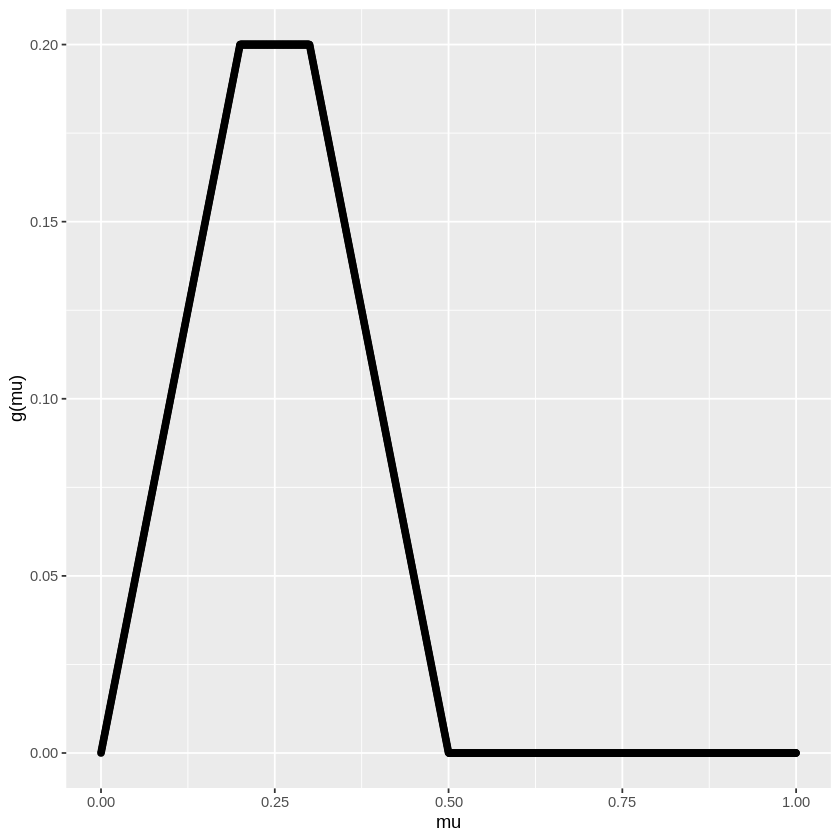

In [10]:
ggplot()+
geom_point(aes(mu, g(mu)))

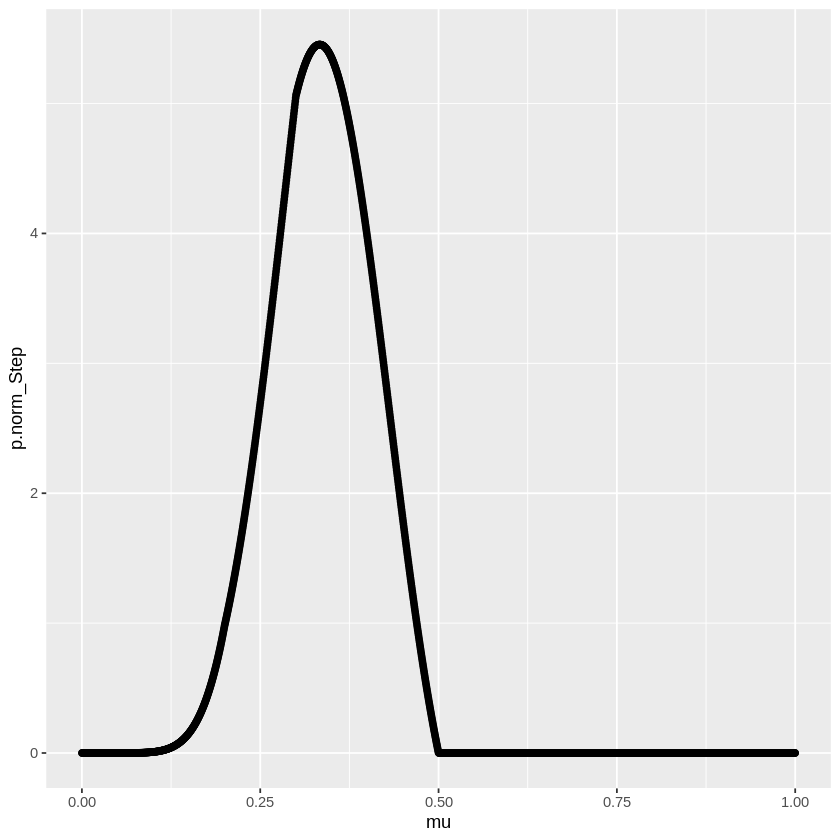

In [11]:
p.star_Step <- dbinom(x=y, size=n, prob=mu) * g(mu)
p.norm_Step <- p.star_Step/ (integrate(function(k) {dbinom(x=y, size=n, prob=k) * g(k)}, lower = 0, upper = 1))$value 

ggplot() +
geom_point(aes(mu, p.norm_Step))

# Plot Posterior distribution

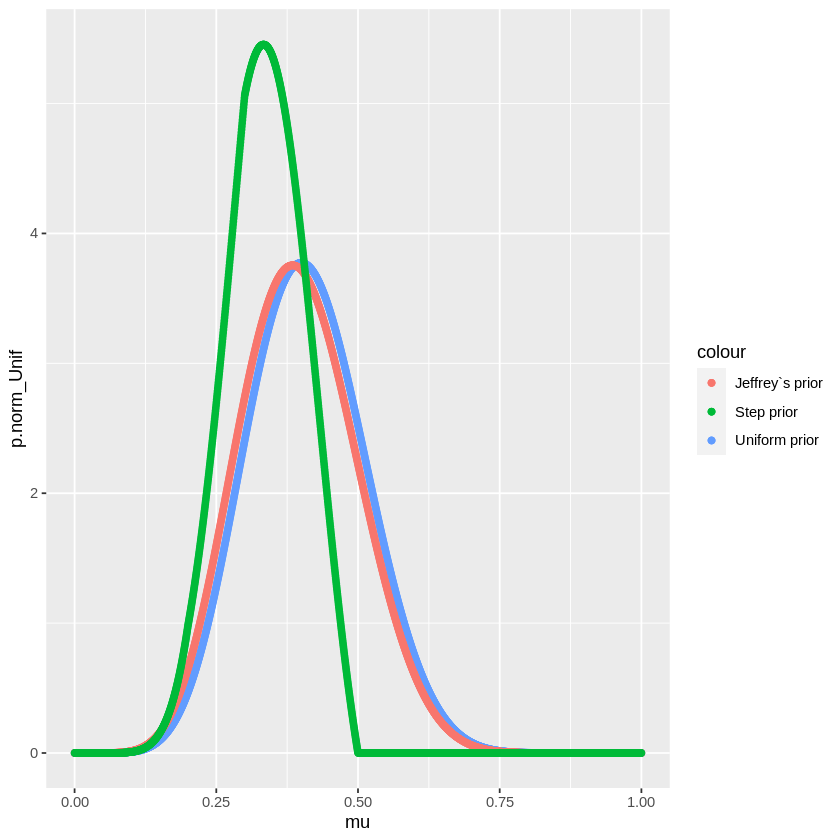

In [12]:
ggplot() +
geom_point(aes(mu, p.norm_Unif, color='Uniform prior')) +
geom_point(aes(mu, p.norm_Jeffrey, color='Jeffrey`s prior')) +
geom_point(aes(mu, p.norm_Step, color='Step prior')) -> posterior_plot
posterior_plot

## First and Second Momenta

Prior,First_momenta,Second_momenta
<chr>,<dbl>,<dbl>
Uniform,0.4090909,0.010510241
Jeffrey`s,0.3953488,0.010624362
Step,0.3350930,0.004673032


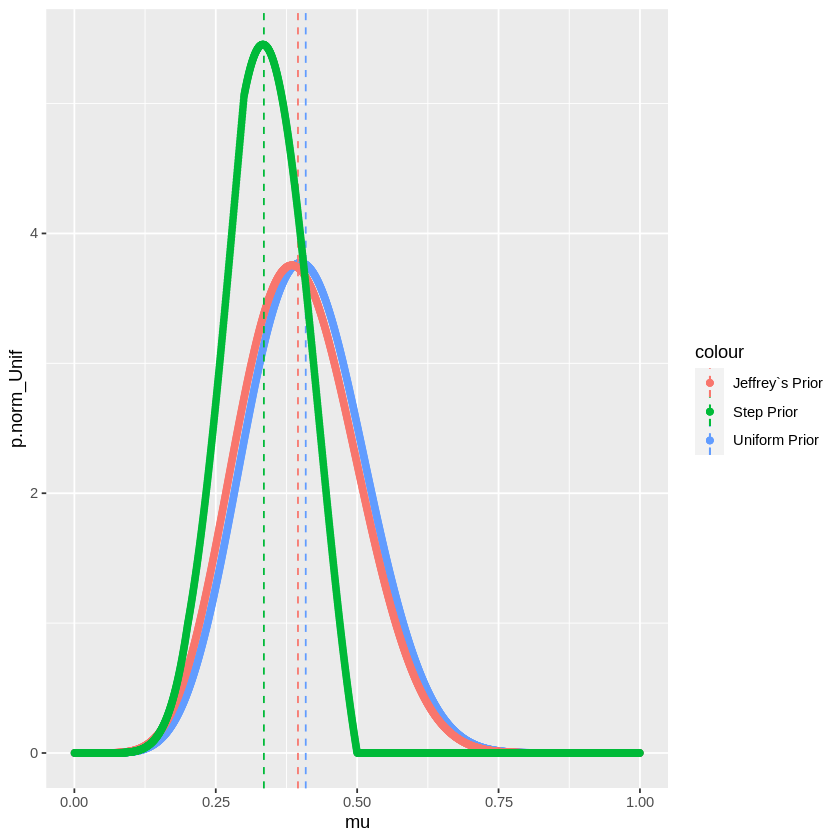

In [172]:
y <- 8; n <- 20; n.sample <- 2000; delta.mu <- 1/n.sample; 
mu <- seq(from=1/(2*n.sample), by=1/n.sample, length.out = n.sample)

#Uniform prior
p.star_Unif<- dbinom(x=y, size=n, prob=mu) * dunif(mu, min=0, max=1)
p.norm_Unif <- p.star_Unif/(delta.mu * sum(p.star_Unif))
first_moment_Unif <- delta.mu * sum(mu * p.norm_Unif)
second_moment_Unif <- delta.mu * sum(((first_moment_Unif-mu)**2)*p.norm_Unif)


#Jeffrey prior
p.star_Jeffrey <- dbinom(x=y, size=n, prob=mu) * 1/(mu ** (1/2))
p.norm_Jeffrey <- p.star_Jeffrey / (delta.mu*sum(p.star_Jeffrey))
first_moment_Jeffrey <- delta.mu * sum(mu * p.norm_Jeffrey)
second_moment_Jeffrey <- delta.mu * sum(((first_moment_Jeffrey-mu)**2) * p.norm_Jeffrey)


#Step prior
p.star_Step <- dbinom(x=y, size=n, prob=mu) * g(mu)
p.norm_Step <- p.star_Step / (delta.mu * sum(p.star_Step))
first_moment_Step <- delta.mu * sum(mu * p.norm_Step)
second_moment_Step <- delta.mu * sum(((first_moment_Step-mu)**2) * p.norm_Step)

#PLot
ggplot()+ 
geom_point(aes(mu, p.norm_Unif, color='Uniform Prior')) +
geom_vline(aes(xintercept=first_moment_Unif, color='Uniform Prior'), linetype='dashed')+

geom_point(aes(mu, p.norm_Jeffrey, color='Jeffrey`s Prior'))+
geom_vline(aes(xintercept=first_moment_Jeffrey, color='Jeffrey`s Prior'), linetype='dashed') +

geom_point(aes(mu, p.norm_Step, color='Step Prior'))+
geom_vline(aes(xintercept=first_moment_Step, color='Step Prior'), linetype='dashed')



Momenta <- tibble(
            Prior = c('Uniform', 'Jeffrey`s', 'Step'),
            First_momenta  = c(first_moment_Unif,  first_moment_Jeffrey,  first_moment_Step),
            Second_momenta = c(second_moment_Unif, second_moment_Jeffrey, second_moment_Step),
            )
Momenta

# Compute 95% credibility interval and Plot the limits
The function `ncredit` is used in order to compute the credibility interval

Prior,Lower_bound,Upper_bound
<chr>,<dbl>,<dbl>
Uniform,0.21275,0.60975
Jeffrey,0.19875,0.59725
Step,0.20575,0.46625


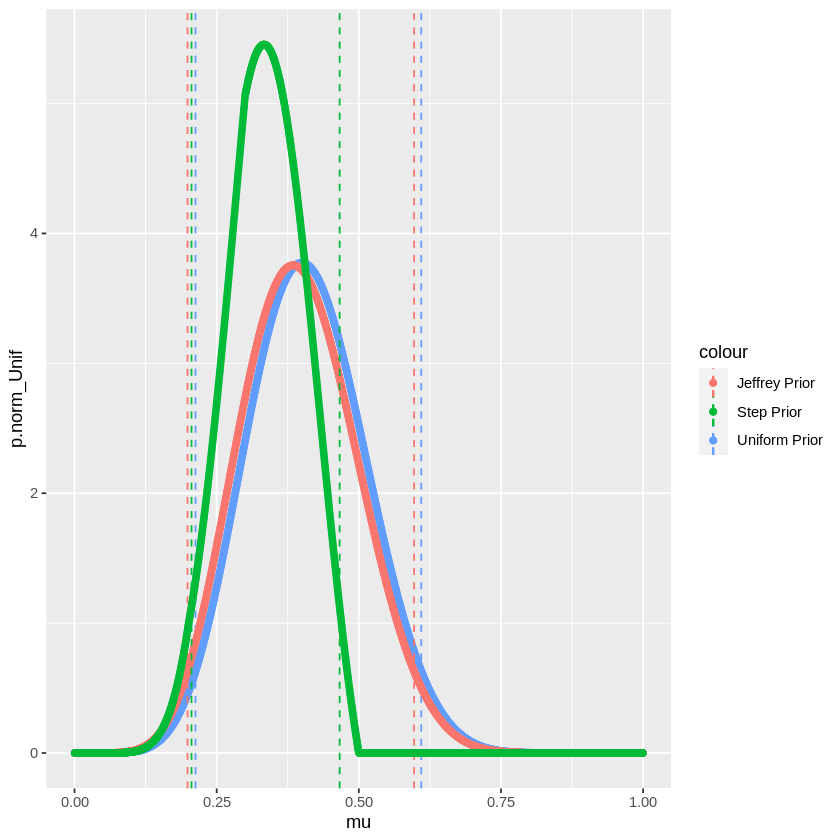

In [147]:
# Uniform prior
lower_bound_Unif <- ncredint(mu, p.norm_Unif, level=0.95)[['lower']]
upper_bound_Unif <- ncredint(mu, p.norm_Unif, level=0.95)[['upper']]

# Jeffrey prior
lower_bound_Jeffrey <- ncredint(mu, p.norm_Jeffrey, level=0.95)[['lower']]
upper_bound_Jeffrey <- ncredint(mu, p.norm_Jeffrey, level=0.95)[['upper']]

# Step prior
lower_bound_Step <- ncredint(mu, p.norm_Step, level=0.95)[['lower']]
upper_bound_Step <- ncredint(mu, p.norm_Step, level=0.95)[['upper']]

#Summary table
Credibility_Interval <- tibble(
                        Prior = c('Uniform', 'Jeffrey', 'Step'),
                        Lower_bound = c(lower_bound_Unif, lower_bound_Jeffrey, lower_bound_Step),
                        Upper_bound = c(upper_bound_Unif, upper_bound_Jeffrey, upper_bound_Step)
                        )
Credibility_Interval

#Plot the limits
ggplot()+ 
geom_point(aes(mu, p.norm_Unif, color='Uniform Prior')) +
geom_vline(aes(xintercept=lower_bound_Unif,color='Uniform Prior'), linetype='dashed')+
geom_vline(aes(xintercept=upper_bound_Unif, color='Uniform Prior'), linetype='dashed')+

geom_point(aes(mu, p.norm_Jeffrey, color='Jeffrey Prior')) +
geom_vline(aes(xintercept=lower_bound_Jeffrey,color='Jeffrey Prior'), linetype='dashed')+
geom_vline(aes(xintercept=upper_bound_Jeffrey, color='Jeffrey Prior'), linetype='dashed') +

geom_point(aes(mu, p.norm_Step, color='Step Prior')) +
geom_vline(aes(xintercept=lower_bound_Step,color='Step Prior'), linetype='dashed')+
geom_vline(aes(xintercept=upper_bound_Step, color='Step Prior'), linetype='dashed')


# Ex.2 

## Plot the posterior distribution and compute first and second moments

Prior,First_moment,Second_moment
<chr>,<dbl>,<dbl>
Unif,0.1525424,0.001086329
Beta,0.1487603,0.001037957


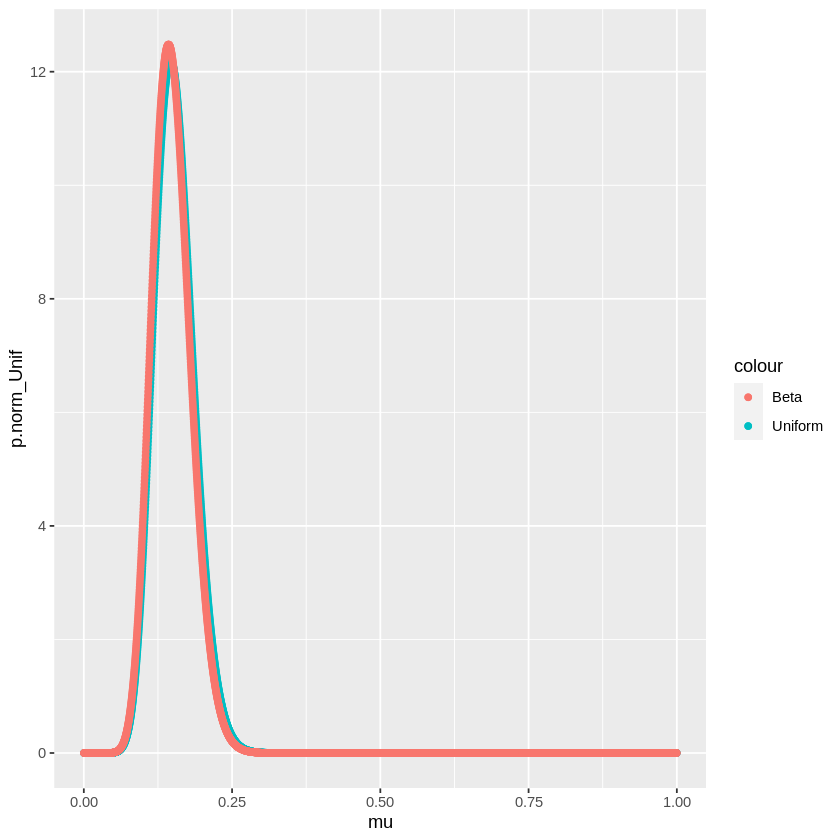

In [178]:
n <- 116
y <- 17
n.sample <- 4000; delta.mu <- 1/n.sample
mu <- seq(from=1/(2*n.sample), by = delta.mu, length.out = n.sample)

# Uniform prior
p.star_Unif <- dbinom(x=y, size=n, prob=mu) * dunif(mu, min = 0, max=1)
p.norm_Unif <- p.star_Unif/(delta.mu * sum(p.star_Unif))
first_moment_Unif <- delta.mu * sum(mu * p.norm_Unif)
second_moment_Unif <- delta.mu * sum(((first_moment_Unif-mu)**2) * p.norm_Unif)

#Beta prior
p.star_Beta <- dbinom(x=y, size=n, prob=mu) * dbeta(mu,1,4)
p.norm_Beta <- p.star_Beta / (delta.mu * sum(p.star_Beta))
first_moment_Beta <- delta.mu * sum(mu * p.norm_Beta)
second_moment_Beta <- delta.mu * sum(((first_moment_Beta - mu)**2) * p.norm_Beta)

Momenta <- tibble(
            Prior = c('Unif', 'Beta'),
            First_moment = c(first_moment_Unif, first_moment_Beta),
            Second_moment = c(second_moment_Unif, second_moment_Beta)
            )
Momenta

ggplot() +
geom_point(aes(mu, p.norm_Unif, color='Uniform')) +
geom_point(aes(mu, p.norm_Beta, color='Beta')) 


## Find a normal approximation for the posterior
For the normal posterior distribution I'm gonna use a normal distribution with mean eqaul to the first moments of the posterior distribution find in the last ex, same for the std 

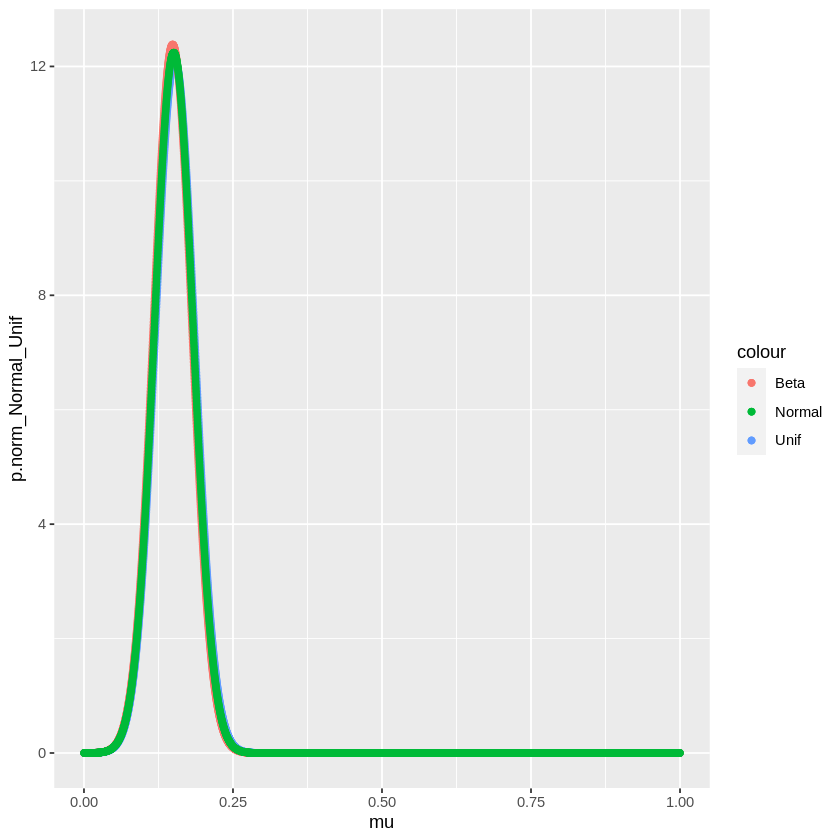

In [180]:
p.norm_Normal_Unif <- dnorm(mu, mean=first_moment_Unif, sd=sqrt(second_moment_Unif))
p.norm_Normal_Beta <- dnorm(mu, mean=first_moment_Beta, sd=sqrt(second_moment_Beta))

p.norm_Normal <- dnorm(mu, mean=(first_moment_Unif + first_moment_Beta)/2, 
                         sd=sqrt((second_moment_Unif + second_moment_Beta)/2))

ggplot() +
geom_point(aes(mu, p.norm_Normal_Unif, color='Unif'))+
geom_point(aes(mu, p.norm_Normal_Beta, color='Beta')) +
geom_point(aes(mu, p.norm_Normal, color='Normal')) 


## Compute a 95% credibility interval both for the original posterior and for the normal approximation, giving the results in a summary table

In [186]:
lower_bound_Unif <- ncredint(mu, p.norm_Unif, level = 0.95)[['lower']]
upper_bound_Unif <- ncredint(mu, p.norm_Unif, level = 0.95)[['upper']]

lower_bound_Beta <- ncredint(mu, p.norm_Beta, level = 0.95)[['lower']]
upper_bound_Beta <- ncredint(mu, p.norm_Beta, level = 0.95)[['upper']]

lower_bound_Normal <- ncredint(mu, p.norm_Normal, level = 0.95)[['lower']]
upper_bound_Normal <- ncredint(mu, p.norm_Normal, level = 0.95)[['upper']]

Credibility_Interval <- tibble(
                        Prior = c('Unif', 'Beta', 'Normal approximation'),
                        lower_bound = c(lower_bound_Unif, lower_bound_Beta, lower_bound_Normal),
                        upper_bound = c(upper_bound_Unif, upper_bound_Beta, upper_bound_Normal)
                        )
Credibility_Interval

Prior,lower_bound,upper_bound
<chr>,<dbl>,<dbl>
Unif,0.090375,0.217875
Beta,0.088125,0.212625
Normal approximation,0.086875,0.214375


## Add the limits on the plot of the posterior distributions

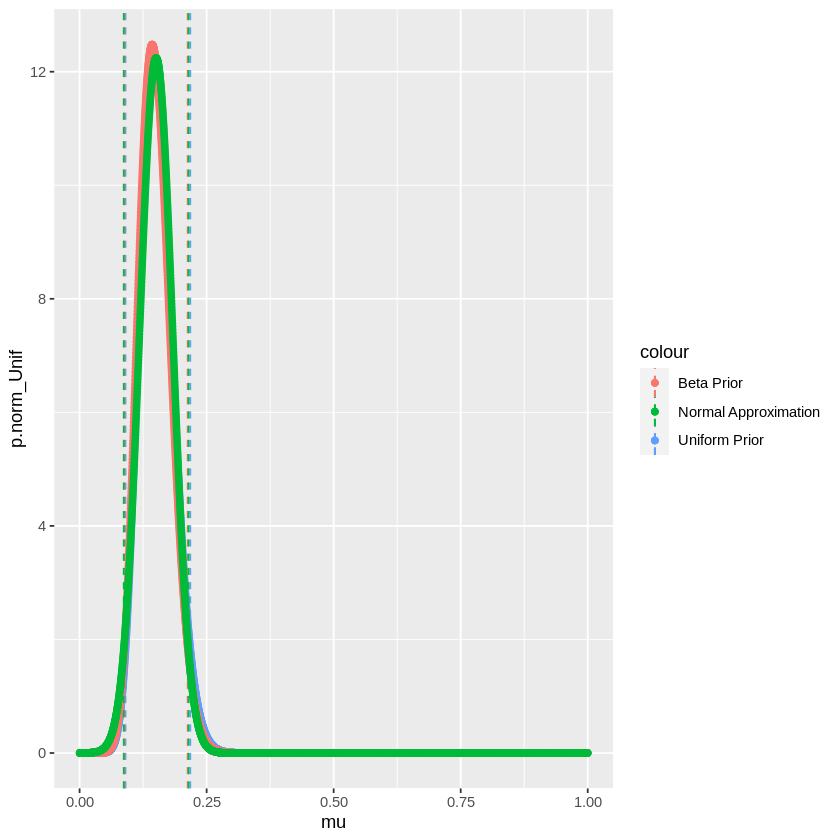

In [188]:
ggplot() +
geom_point(aes(mu, p.norm_Unif, color='Uniform Prior')) +
geom_vline(aes(xintercept=lower_bound_Unif,color='Uniform Prior'), linetype='dashed')+
geom_vline(aes(xintercept=upper_bound_Unif, color='Uniform Prior'), linetype='dashed')+

geom_point(aes(mu, p.norm_Beta, color='Beta Prior')) +
geom_vline(aes(xintercept=lower_bound_Beta,color='Beta Prior'), linetype='dashed')+
geom_vline(aes(xintercept=upper_bound_Beta, color='Beta Prior'), linetype='dashed') +

geom_point(aes(mu, p.norm_Normal, color='Normal Approximation')) +
geom_vline(aes(xintercept=lower_bound_Normal,color='Normal Approximation'), linetype='dashed')+
geom_vline(aes(xintercept=upper_bound_Normal, color='Normal Approximation'), linetype='dashed')

# Ex. 3

## Assuming a flat prior, and a beta prior, plot the likelihood, prior and posterior distributions for the data set

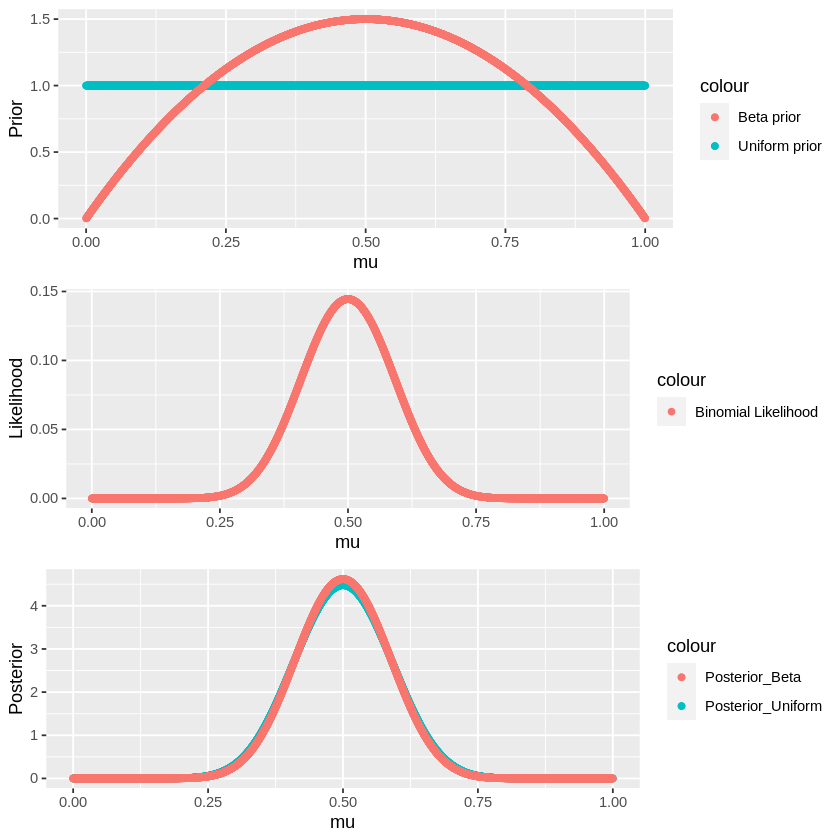

In [214]:
n <- 30 
y <- 15

n.sample <- 4001; delta.mu = 1/n.sample
mu <- seq(from=1/(2*n.sample), by = delta.mu, length.out = n.sample)

# Uniform prior
p.star_Unif <- dbinom(x=y, size=n, prob=mu) * dunif(mu, min = 0, max=1)
p.norm_Unif <- p.star_Unif/(delta.mu * sum(p.star_Unif))
first_moment_Unif <- delta.mu * sum(mu * p.norm_Unif)
second_moment_Unif <- delta.mu * sum(((first_moment_Unif-mu)**2) * p.norm_Unif) 

#Beta prior
p.star_Beta <- dbinom(x=y, size=n, prob=mu) * dbeta(mu,2, 2)
p.norm_Beta <- p.star_Beta / (delta.mu * sum(p.star_Beta))
first_moment_Beta <- delta.mu * sum(mu * p.norm_Beta)
second_moment_Beta <- delta.mu * sum(((first_moment_Beta - mu)**2) * p.norm_Beta)

#Prior plot
ggplot() +
geom_point(aes(mu, dunif(mu, min=0, max=1), color='Uniform prior')) +
geom_point(aes(mu, dbeta(mu, 2,2), colour='Beta prior')) +
labs(y='Prior')-> prior_plot
           
#Likelihood plot
ggplot() +
geom_point(aes(mu, dbinom(x=y, size=n, prob=mu), color='Binomial Likelihood')) +
labs(y='Likelihood')-> Likelihood_plot

#Posterior plot
ggplot() +
geom_point(aes(mu, p.norm_Unif, color='Posterior_Uniform')) +
geom_point(aes(mu, p.norm_Beta, color='Posterior_Beta'))+
labs(y='Posterior')-> posterior_plot


grid.arrange(prior_plot, Likelihood_plot, posterior_plot, nrow=3)

## Evaluate the most probable value for the coin probability p and, integrating the posterior probability distribution, give an estimate for a 95% credibility interval

In [215]:
cat('The most probable value is:', mu[which.max(p.norm_Beta)])

The most probable value is: 0.5

In [216]:
lower_bound <- ncredint(mu, p.norm_Beta, level=0.95)[['lower']]
upper_bound <- ncredint(mu, p.norm_Beta, level=0.95)[['upper']]
cat('The 95% credibility interval is:','[', lower_bound, ',', upper_bound, ']')

The 95% credibility interval is: [ 0.3355411 , 0.6644589 ]

## Repeat the same analysis assuming a sequential analysis of the data 1. Show how the most probable value and the credibility interval change as a function of the number of coin tosses (i.e. from 1 to 30)

Head H is 1, Tail is 0

In [221]:
trial = c(0,0,0,0,0,1,0,0,1,1,0,0,1,1,1,0,1,0,1,0,1,1,0,1,0,1,0,1,1,1)

In [241]:
t <- c()

most_prob_Unif <- c()
most_prob_Beta <- c()

t_lower_bound_Unif <- c()
t_upper_bound_Unif <- c()
t_lower_bound_Beta <- c()
t_upper_bound_Beta <- c()

for(i in trial){
    t <- c(t,i)
    n <- length(t)
    y <- sum(t)

    n.sample <- 4001; delta.mu = 1/n.sample
    mu <- seq(from=1/(2*n.sample), by = delta.mu, length.out = n.sample)

    # Uniform prior
    p.star_Unif <- dbinom(x=y, size=n, prob=mu) * dunif(mu, min = 0, max=1)
    p.norm_Unif <- p.star_Unif/(delta.mu * sum(p.star_Unif))
    most_prob_Unif <- c(most_prob_Unif, mu[which.max(p.norm_Unif)])
    t_lower_bound_Unif <- c(t_lower_bound_Unif, ncredint(mu, p.norm_Unif, level=0.95)[['lower']] )
    t_upper_bound_Unif <- c(t_upper_bound_Unif, ncredint(mu, p.norm_Unif, level=0.95)[['upper']] )

    #Beta prior
    p.star_Beta <- dbinom(x=y, size=n, prob=mu) * dbeta(mu,2, 2)
    p.norm_Beta <- p.star_Beta / (delta.mu * sum(p.star_Beta))
    most_prob_Beta <- c(most_prob_Beta, mu[which.max(p.norm_Beta)])
    t_lower_bound_Beta <- c(t_lower_bound_Beta, ncredint(mu, p.norm_Beta, level=0.95)[['lower']] )
    t_upper_bound_Beta <- c(t_upper_bound_Beta, ncredint(mu, p.norm_Beta, level=0.95)[['upper']] )
    }

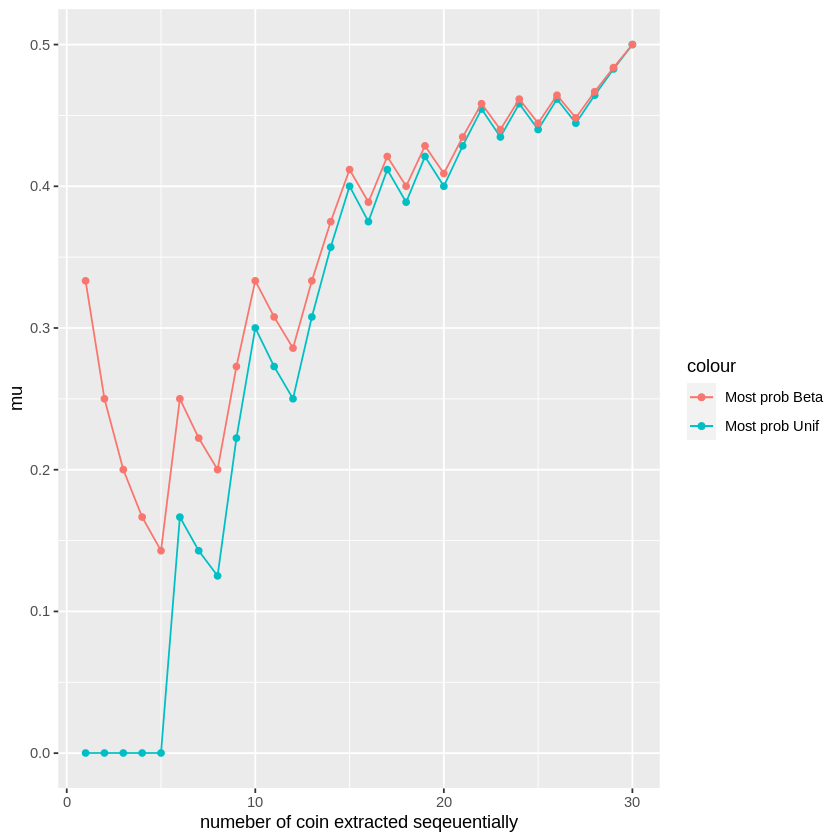

In [258]:
ggplot() +
geom_point(aes(seq(1,30), most_prob_Unif, color='Most prob Unif')) +
geom_line(aes(seq(1,30), most_prob_Unif, color='Most prob Unif')) +
geom_point(aes(seq(1,30), most_prob_Beta, color='Most prob Beta')) +
geom_line(aes(seq(1,30), most_prob_Beta, color='Most prob Beta')) +
labs(x ='numeber of coin extracted seqeuentially', y='mu')

In [252]:
t_upper_bound_Unif

[1] 0.9998750 0.9998750 0.9998750 0.9998750 0.9998750 0.5279930 0.4762559
 [8] 0.4325169 0.5219945 0.5882279 0.5477381 0.5137466 0.5634841 0.6037241
[15] 0.6377156 0.6079730 0.6362159 0.6092227 0.6342164 0.6097226 0.6322169
[22] 0.6522119 0.6299675 0.6489628 0.6277181 0.6452137 0.6254686 0.6417146
[29] 0.6559610 0.6694576

In [ ]:
t

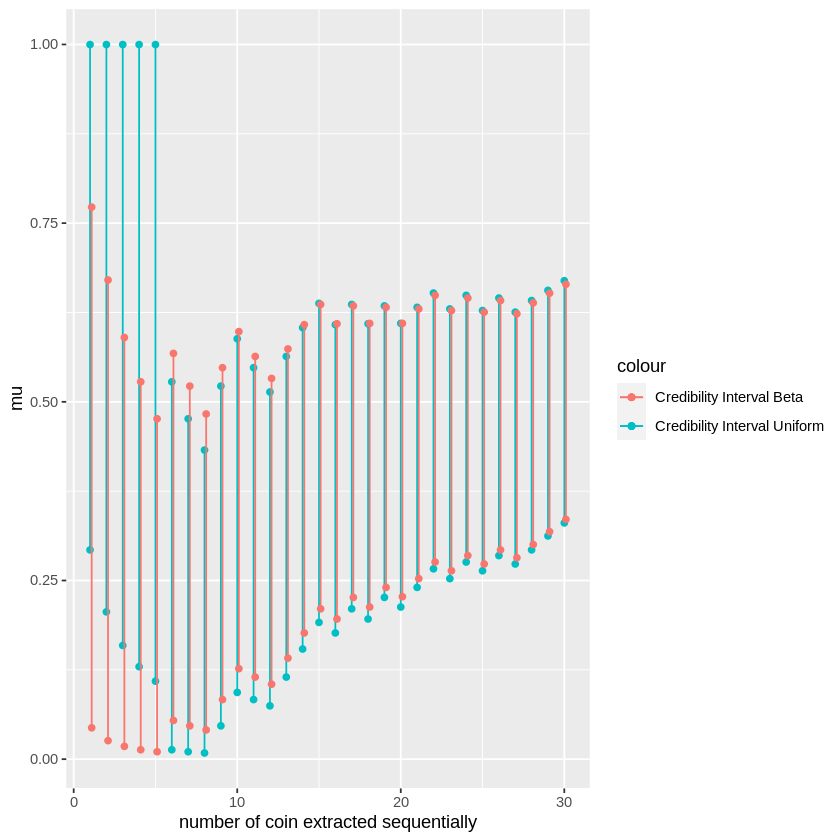

In [259]:
ggplot() +
geom_segment(aes(x = seq(1,30), y= t_lower_bound_Unif, xend=seq(1,30), yend=t_upper_bound_Unif, colour='Credibility Interval Uniform')) +
geom_point(aes(x=seq(1,30), y = t_lower_bound_Unif, colour='Credibility Interval Uniform'))+
geom_point(aes(x=seq(1,30), y = t_upper_bound_Unif, colour='Credibility Interval Uniform')) +
geom_segment(aes(x = seq(from=1.1, to=30.1, by=1), y= t_lower_bound_Beta, xend=seq(from=1.1, to=30.1, by=1), yend=t_upper_bound_Beta, colour='Credibility Interval Beta')) + 
geom_point(aes(x = seq(from=1.1, to=30.1), y = t_lower_bound_Beta, colour='Credibility Interval Beta'))+
geom_point(aes(x = seq(from=1.1, to=30.1), y = t_upper_bound_Beta, colour='Credibility Interval Beta'))+
labs(y='mu', x='number of coin extracted sequentially')

## Do you get a different result, by analyzing the data sequentially with respect to a one-step analysis (i.e. considering all the data as a whole)? 
No, in the end the most probable value and the credibility interval are evaluated in the same way when the last coin result is considered 